# US Accident EDA

This notebook explores the possible relationships between severity of accidents and other conditions at play during the accident.

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

## Data Setup

This section will organize the files so that exploring each section will not be slowed down by unnecessary columns/data.

In [2]:
df = pd.read_csv('US_Accidents.csv')

In [3]:
print(df.describe())

print(df.isna().sum())

print(df.head())

                TMC      Severity     Start_Lat     Start_Lng       End_Lat  \
count  2.478818e+06  3.513617e+06  3.513617e+06  3.513617e+06  1.034799e+06   
mean   2.080226e+02  2.339929e+00  3.654195e+01 -9.579151e+01  3.755758e+01   
std    2.076627e+01  5.521935e-01  4.883520e+00  1.736877e+01  4.861215e+00   
min    2.000000e+02  1.000000e+00  2.455527e+01 -1.246238e+02  2.457011e+01   
25%    2.010000e+02  2.000000e+00  3.363784e+01 -1.174418e+02  3.399477e+01   
50%    2.010000e+02  2.000000e+00  3.591687e+01 -9.102601e+01  3.779736e+01   
75%    2.010000e+02  3.000000e+00  4.032217e+01 -8.093299e+01  4.105139e+01   
max    4.060000e+02  4.000000e+00  4.900220e+01 -6.711317e+01  4.907500e+01   

            End_Lng  Distance(mi)        Number  Temperature(F)  \
count  1.034799e+06  3.513617e+06  1.250753e+06    3.447885e+06   
mean  -1.004560e+02  2.816167e-01  5.975383e+03    6.193512e+01   
std    1.852879e+01  1.550134e+00  1.496624e+04    1.862106e+01   
min   -1.244978e+02 

In [25]:
# These column assignments remove the unnecessary columns for analysis.

main_columns = ['Severity', 'Start_Lat','Start_Lng','Bump', 
                'Roundabout', 'Station','Stop','Traffic_Signal', 
                'Give_Way','Junction','Crossing','No_Exit','Railway',
                'Visibility(mi)',
                'Wind_Speed(mph)','Precipitation(in)','Weather_Condition', 
                'Start_Time','Civil_Twilight']
circumstance_columns = ['Severity', 'Bump', 'Roundabout', 'Station','Stop','Traffic_Signal', 
                        'Give_Way','Junction','Crossing','No_Exit','Railway']

# Data Cleaning

This section will go through the data and update the columns with nans/categorical value and update them accordingly.

#### Weather Condition

In [5]:
""" 
We are checking the NaN values for the time_weather_columns to see where we can realistically
set the value to 0. Columns like Wind_Speed and Visbility are assumed to be unreported
because of insignificance to the accident. We will set them to the 75th percentile. Precipitation
will be set to the mean of the allocated weather condition.
"""

df_main = df[main_columns].copy()

In [6]:
# For this type of analysis, remove the Weather Conditions that are NaNs
df_main = df_main.dropna(subset = ['Weather_Condition'], axis=0)

In [7]:
# This quick check shows that there are columns whose information contradicts each other
print(df_main[df_main['Weather_Condition'] == 'Light Rain']['Precipitation(in)'].isna().sum())

12480


In [8]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(df_main['Weather_Condition'])

#You can use the inverse_transform(y) function to decode the values
df_main['Weather_Condition'] = le.transform(df_main['Weather_Condition'])


#### Precipitation, Wind Speed, and Visibility

In [9]:
# This handles the precipitation problem by weather condition. The remaining NaNs will be set to 0.
columns_to_clean = ['Visibility(mi)','Wind_Speed(mph)','Precipitation(in)']
weather_values = df_main['Weather_Condition'].unique()

def value_cleaning(columns):
    for column in columns_to_clean:
        for weather in weather_values:
            mean_val = df_main[df_main['Weather_Condition'] == weather][column].mean()
            df_main.loc[df_main['Weather_Condition'] == weather, column] = df_main[df_main['Weather_Condition'] == weather][column].fillna(mean_val)


In [10]:
# Function for imputation takes a while. 
value_cleaning(columns_to_clean)

In [11]:
# This changes the remaining precipitation/Wind Speed values

for column in columns_to_clean:
    print(column, df_main[column].isna().sum())
    
df_main.loc[df_main['Precipitation(in)'].isna()] = 0
df_main.loc[df_main['Wind_Speed(mph)'].isna()] = 0

for column in columns_to_clean:
    print(column, df_main[column].isna().sum())

Visibility(mi) 0
Wind_Speed(mph) 23
Precipitation(in) 99
Visibility(mi) 0
Wind_Speed(mph) 0
Precipitation(in) 0


#### Start Latitude and Start Longitude

In [12]:
df_main = df_main[df_main['Start_Lat'] != 0.0]
df_main = df_main[df_main['Start_Lng'] != 0.0]

#### Civil Twilight

In [13]:
#This converts the civil twilight's hour int into year
#df_main = df_main.drop(df.loc[df_main["Start_Time"] == 0])

df_main['timeHour'] = df_main['Start_Time'].apply(lambda x: x[11:13])
df_main['Civil_Twilight'] = df_main['timeHour'].isna().apply(lambda x: 'Day' if (x >= 6 or x <= 16) else 'Night')


#### All Circumstance Columns

In [14]:
for column in circumstance_columns:
    df_main[column] = df_main[column].apply(lambda x: 1 if x else 0)

# Data Visualization

#### Plotting on a Map
This section will create interactive maps that will allow you to look at three cities and their respective accidents.

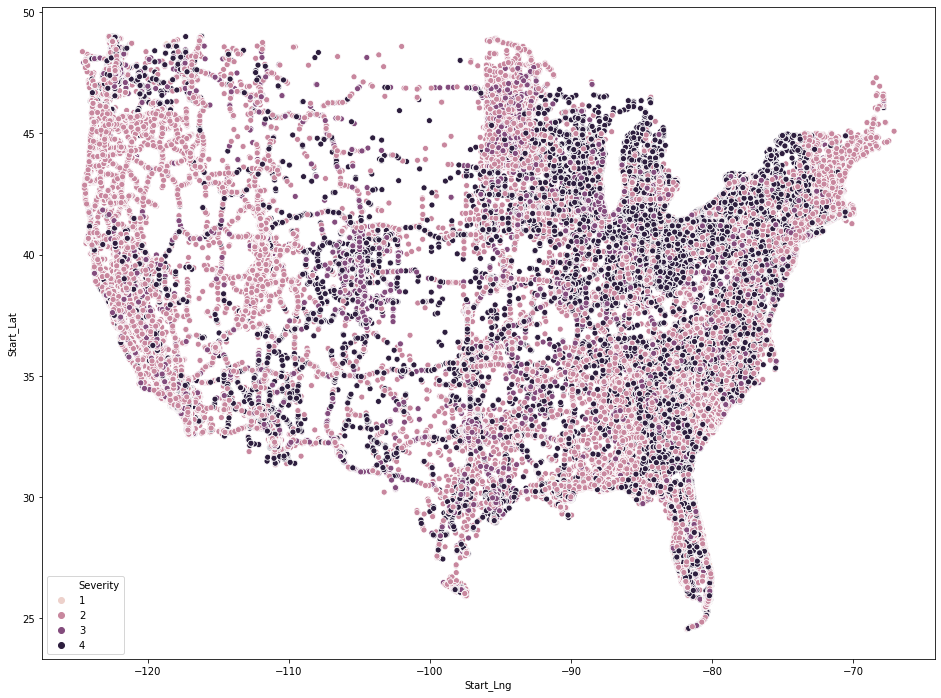

In [15]:
plt.figure(figsize=(16,12))
sns.scatterplot(df_main['Start_Lng'],df_main['Start_Lat'],  hue = df_main['Severity'])
plt.title('Accidents in the United States by Severity')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.show()

In [15]:
import plotly.express as px

def make_heatmap(data, lati, long, setTitle = 'defaultTitle'):
    fig = px.density_mapbox(data, lat='Start_Lat', lon='Start_Lng', z='Severity', radius=4,
                            center=dict(lat=lati, lon=long), zoom=10,
                            mapbox_style='carto-positron', opacity = 0.65,
                            title = setTitle)
    fig.show()

In [16]:
latlongSF = [37.77, -122.4]
latlongLA = [34.05, -118.24]
latlongSD = [32.71, -117.16]
buffer = 0.2

location_columns = ['Start_Lat','Start_Lng','Severity']

df_SF = df_main[df['Start_Lng'] < latlongSF[1] + buffer][df['Start_Lat'] < latlongSF[0] + buffer][location_columns]
df_LA = df_main[df['Start_Lng'] < latlongLA[1] + buffer][df['Start_Lat'] < latlongLA[0] + buffer][location_columns]
df_SD = df_main[df['Start_Lng'] < latlongSD[1] + buffer][df['Start_Lat'] < latlongSD[0] + 0.75][location_columns]

<ipython-input-16-445e4279075e>:8: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_SF = df_main[df['Start_Lng'] < latlongSF[1] + buffer][df['Start_Lat'] < latlongSF[0] + buffer][location_columns]
<ipython-input-16-445e4279075e>:9: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_LA = df_main[df['Start_Lng'] < latlongLA[1] + buffer][df['Start_Lat'] < latlongLA[0] + buffer][location_columns]
<ipython-input-16-445e4279075e>:10: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_SD = df_main[df['Start_Lng'] < latlongSD[1] + buffer][df['Start_Lat'] < latlongSD[0] + 0.75][location_columns]


In [31]:
print(df_SD.head())

       Start_Lat   Start_Lng  Severity
42886  32.765957 -117.128319         3
42895  32.702854 -117.012970         2
42905  32.812195 -117.120201         2
42906  32.836658 -117.000664         2
42909  32.830540 -117.167587         3


In [25]:
make_heatmap(df_SF, latlongSF[0], latlongSF[1], setTitle = 'Accidents in San Francisco by Severity')

In [26]:
make_heatmap(df_LA, latlongLA[0], latlongLA[1], setTitle = 'Accidents in Los Angeles by Severity')

Note: There seems to be pockets of more severe accident rates in residential zones. These are medium density apartment zones that often all parking spaces taken every hour of the day

In [27]:
make_heatmap(df_SD, latlongSD[0], latlongSD[1],  setTitle = 'Accidents in San Diego by Severity')

#### Exploring Relationships Between Variables
This section will explore the relationship between the circumstantial columns during an accident to see if there is an area that has had the most 

In [37]:
df_circumstance = df[circumstance_columns].copy()
for column in circumstance_columns:
    if column != 'Severity': 
        df_circumstance[column] = df_circumstance[column].apply(lambda x: 1 if x else 0)
print(df_circumstance.head())

   Severity  Bump  Roundabout  Station  Stop  Traffic_Signal  Give_Way  \
0         3     0           0        0     0               0         0   
1         2     0           0        0     0               0         0   
2         2     0           0        0     0               1         0   
3         3     0           0        0     0               0         0   
4         2     0           0        0     0               1         0   

   Junction  Crossing  No_Exit  Railway  
0         0         0        0        0  
1         0         0        0        0  
2         0         0        0        0  
3         0         0        0        0  
4         0         0        0        0  


##### ---

##### Circumstance Columns

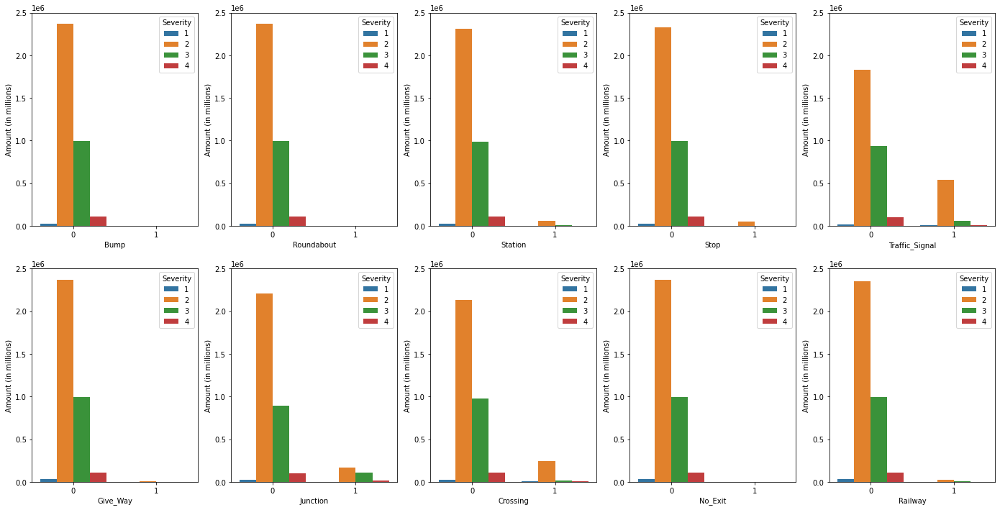

In [92]:
# circumstance_columns

plt.figure(figsize = (24,12))

for i in range(len(circumstance_columns)-1):
    plt.subplot(2,5, i+1)
    sns.countplot(data = df_circumstance, x=circumstance_columns[i+1], hue='Severity')
    plt.ylabel('Amount (in millions)')
    plt.ylim([0,2500000])
plt.show()

In [47]:
# Creates a zipped reference object
circumstance_amount = []
for i in range(len(circumstance_columns)-1):
    circumstance_amount.append(df[circumstance_columns[i+1]].sum())
circumstance_related = list(zip(circumstance_columns[1:], circumstance_amount))

[('Bump', 606), ('Roundabout', 184), ('Station', 70321), ('Stop', 51976), ('Traffic_Signal', 623623), ('Give_Way', 9564), ('Junction', 284449), ('Crossing', 274526), ('No_Exit', 4384), ('Railway', 31175)]


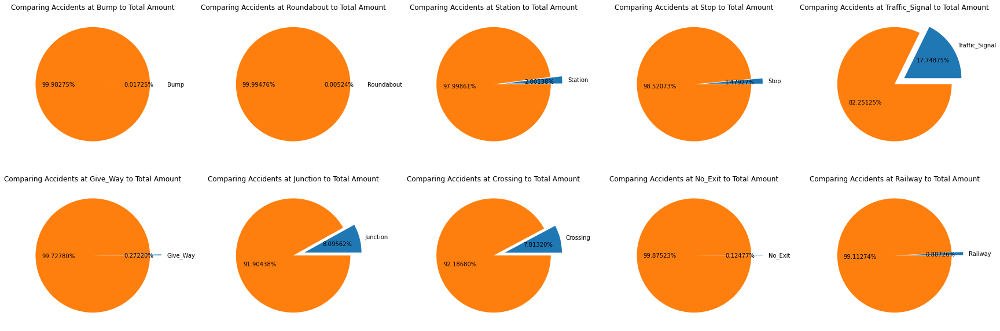

In [116]:
# Percent of total accidents caused by specific circumstance
plt.figure(figsize=(30,10))

for i in range(len(circumstance_related)):
    plt.subplot(2,5,i+1)
    plt.pie([circumstance_related[i][1],total_accidents - circumstance_related[i][1]],
            labels=(circumstance_related[i][0],''),
            autopct='%1.5f%%',
            explode=(0.2,0))
    plt.title('Comparing Accidents at {} to Total Amount'.format(circumstance_related[i][0]))



Traffic signals, junctions, and corssings are the most common place for accidents to occur.

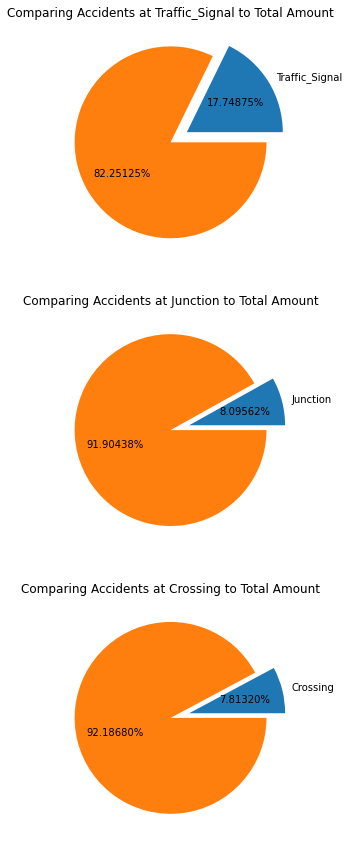

In [99]:
plt.figure(figsize=(12,15))
for i in range(len(circumstance_most_important)):
    plt.subplot(3,1,i+1)
    plt.pie([circumstance_most_important[i][1],total_accidents - circumstance_most_important[i][1]],
        labels=(circumstance_most_important[i][0],''),
        autopct='%1.5f%%',
        explode=(0.2,0))
    plt.title('Comparing Accidents at {} to Total Amount'.format(circumstance_most_important[i][0]))
    

#### Time Based Data
This section will explore the data on a time evolving basis. Do specific months of the year have an increase in accidents


In [141]:
print(df_main.head())

   Severity  Start_Lat  Start_Lng  Bump  Roundabout  Station  Stop  \
0         3  39.865147 -84.058723     0           0        0     0   
1         2  39.928059 -82.831184     0           0        0     0   
2         2  39.063148 -84.032608     0           0        0     0   
3         3  39.747753 -84.205582     0           0        0     0   
4         2  39.627781 -84.188354     0           0        0     0   

   Traffic_Signal  Give_Way  Junction  Crossing  No_Exit  Railway  \
0               0         0         0         0        0        0   
1               0         0         0         0        0        0   
2               1         0         0         0        0        0   
3               0         0         0         0        0        0   
4               1         0         0         0        0        0   

   Visibility(mi)  Wind_Speed(mph)  Precipitation(in)  Weather_Condition  \
0            10.0         8.861257           0.020000                 55   
1           

#### Weather Based Data
This section will explore the impact of weather and visibility to the severity and frequency of accidents.

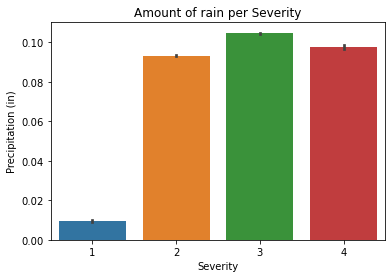

In [37]:
"""
Accidents are more severe when there is slight rain present during the accidnet. Death (4) 
is not guaranteed during higher amounts, but it is positively correlated.
"""

sns.barplot(data = df_main, y = 'Precipitation(in)',x='Severity')
plt.title('Amount of rain per Severity')
plt.ylabel('Precipitation (in)')
plt.show()